In [ ]:
# 1- KNN Classification-Binary(1)

- Prepared By: Ammar Nassan Alhaj Ali.
- Date: 2020-10-14.
- References: 1-introduction to machine learning with python a guide for data scientists 2017 (Andreas C. Müller and Sarah Guido).

- Classification is sometimes separated into binary classification,which is the special case of distinguishing between exactly two classes:
- You can think of binary classification as trying to answer a yes/no question. 
- Classifying emails as either spam or not spam is an example of a binary classification problem.

In [17]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import mglearn
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import matplotlib.patches as mpatches
from sklearn import neighbors
import numpy as np

In [18]:
def plot_two_class_knn(X, y, n_neighbors,X_test,y_test):

    X_train=X
    y=y_train
    cmap_light = ListedColormap(['#FFFF77', '#0000FF', '#0000FF','#EFEFEF'])
    cmap_bold  = ListedColormap(['#FFFF00', '#00FF00', '#00FF00','#000000'])

    h = .02  # step size in the mesh
    # we create an instance of Neighbours Classifier and fit the data.
    clf = neighbors.KNeighborsClassifier(n_neighbors)
    clf.fit(X_train, y_train)
    #-------------------------------------------------------------------------------------
    # Plot the decision boundary. For that, we will assign a color to each
    # point in the mesh [x_min, x_max]x[y_min, y_max].
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),np.arange(y_min, y_max, h))
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    # Put the result into a color plot
    Z = Z.reshape(xx.shape)
    #-------------------------------------------------------------------------------------
    plt.figure(figsize=(8,6))
    plt.pcolormesh(xx, yy, Z, cmap=cmap_light)
    # Plot also the training points
    plt.scatter(X[:, 0], X[:, 1], c=y, cmap=cmap_bold,edgecolor='k', s=60)
    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    title = "Neighbors = {}".format(n_neighbors)
    if (X_test is not None):
            train_score = clf.score(X_train, y_train)
            test_score  = clf.score(X_test, y_test)
            title = title + "\nTrain score = {:.2f}, Test score = {:.2f}".format(train_score, test_score)
    plt.title(title)
    patch0 = mpatches.Patch(color='#FFFF00', label='class 0')
    patch1 = mpatches.Patch(color='#000000', label='class 1')
    plt.legend(handles=[patch0, patch1])
    plt.show()



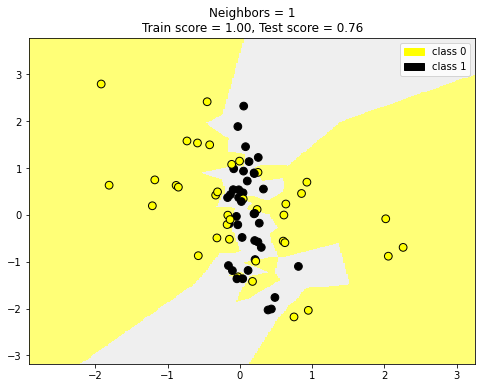

In [19]:
#sklearn.datasets.make_classification Generate a random n-class classification problem
X, y = make_classification(n_samples = 100, n_features=2,
                                   n_redundant=0, n_informative=2,
                                   n_clusters_per_class=1, flip_y = 0.1,
                                   class_sep = 0.1, random_state=0)
X_train, X_test, y_train, y_test = train_test_split(X, y,train_size=0.75,random_state=0)

plot_two_class_knn(X_train,y_train,1,X_test,y_test)
